In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!mkdir /content/MyDrive
!mount --bind /content/drive/My\ Drive /content/MyDrive
# the magic % will help with the cd command :)
%cd /content

In [ ]:
!pip install scanpy
!pip install squidpy
!pip install scikit-image
!pip install tangram-sc
!pip install gdown
# to upgrade
!pip install --upgrade gdown

In [1]:
import scanpy as sc
import squidpy as sq
import numpy as np
import pandas as pd
from anndata import AnnData
import pathlib
import matplotlib.pyplot as plt
import matplotlib as mpl
import skimage
import seaborn as sns
import tangram as tg

# 1. Load in Files

There are 3 files you have to load in to this notebook.

1. `adata_sc`: The single cell data file

2. `adata_st`: The preprocessed spatial data file. It is a result of the previous notebook `Tangram_GPU.ipynb`. 

3. `ad_map`: The spatial mapping file. It is a result of the previous notebook `Tangram_GPU.ipynb`.

In [2]:
adata_sc = sc.read_h5ad("pasca.log1p_liger_med_singleR_noglyc.h5ad")
adata_st = sc.read_h5ad("500_hbs1_adata_st.h5ad")
ad_map1 = sc.read_h5ad("500_hbs1_ad_map1.h5ad")
ad_map2 = sc.read_h5ad("500_hbs1_ad_map2.h5ad")
#ad_ge = sc.read_h5ad("ad_ge.h5ad")

In [3]:
filter_val = ['GSM4306931_Control_1', 'GSM4306932_Control_2']
adata_sc1 = adata_sc[adata_sc.obs['sampleID'].isin(filter_val),:]
adata_sc2 = adata_sc[~adata_sc.obs['sampleID'].isin(filter_val),:]

# 2. Analyzing data

## 2.1 Visualizing initial data 

In [4]:
img = sq.datasets.visium_fluo_image_crop()

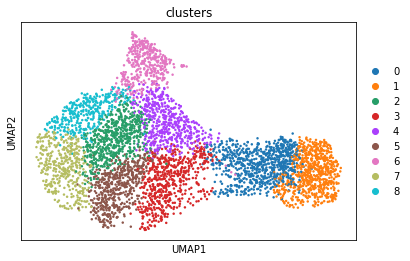

In [5]:
sc.pl.umap(
    adata_st, color=["clusters"], palette=sc.pl.palettes.default_20
)

In [6]:
clusters_colors = dict(
    zip([str(i) for i in range(18)], adata_st.uns["clusters_colors"])
)

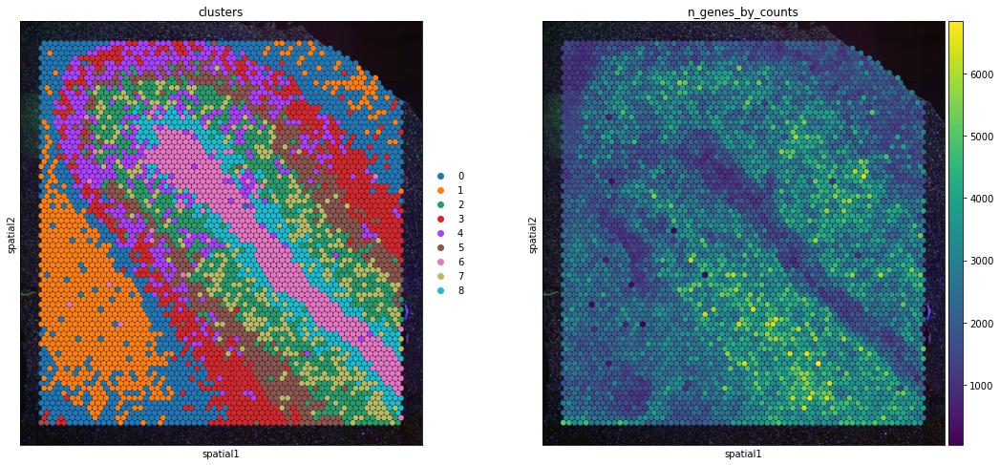

In [7]:
plt.rcParams["figure.figsize"] = (8, 8)
ad = adata_st.copy()
sc.pl.spatial(
  ad,
  img_key="hires",
  color=["clusters","n_genes_by_counts"],
  size=1.5,
  palette=[
    v
    for k, v in clusters_colors.items()
    if k in ad.obs.clusters.unique().tolist()
    ],
  legend_loc='right margin',
  show=False,
    )

plt.tight_layout()
del ad

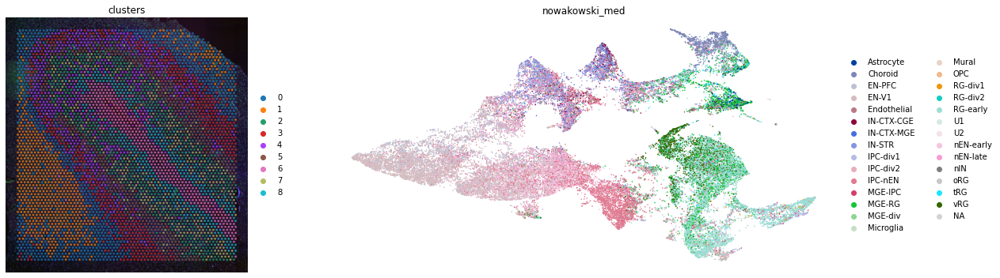

In [8]:
fig, axs = plt.subplots(1, 2, figsize=(20, 5))
sc.pl.spatial(
    adata_st, color="clusters", alpha=0.7, frameon=False, show=False, ax=axs[0]
)
sc.pl.umap(
    adata_sc, color="nowakowski_med", size=10, frameon=False, show=False, ax=axs[1]
)
plt.tight_layout()

## 2.2 Pre-process AnnDatas

This preprocessing is required for `adata_sc` to be in the correct format for further experiments.

In [9]:
adata_sc.uns['log1p']["base"] = None
adata_sc1.uns['log1p']["base"] = None
adata_sc2.uns['log1p']["base"] = None

sc.tl.rank_genes_groups(adata_sc, groupby="nowakowski_med", use_raw=False)
markers_df = pd.DataFrame(adata_sc.uns["rank_genes_groups"]["names"]).iloc[0:100, :]
markers = list(np.unique(markers_df.melt().value.values))
len(markers)

adata_st_cp = adata_st.copy()
tg.pp_adatas(adata_sc1, adata_st, genes=markers)
tg.pp_adatas(adata_sc2, adata_st_cp, genes=markers)

INFO:root:1301 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:20358 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.
INFO:root:1301 training genes are saved in `uns``training_genes` of both single cell and spatial Anndatas.
INFO:root:20823 overlapped genes are saved in `uns``overlap_genes` of both single cell and spatial Anndatas.
INFO:root:uniform based density prior is calculated and saved in `obs``uniform_density` of the spatial Anndata.
INFO:root:rna count based density prior is calculated and saved in `obs``rna_count_based_density` of the spatial Anndata.


In [10]:
# alternative 2: saving the experiment result from the previous gpu notebook can be used but pp_adatas don't take much time.
# It is not worth generating another intermediate file.
#adata_sc = sc.read_h5ad("adata_sc.h5ad")

## 2.3 Visualize cell type maps

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


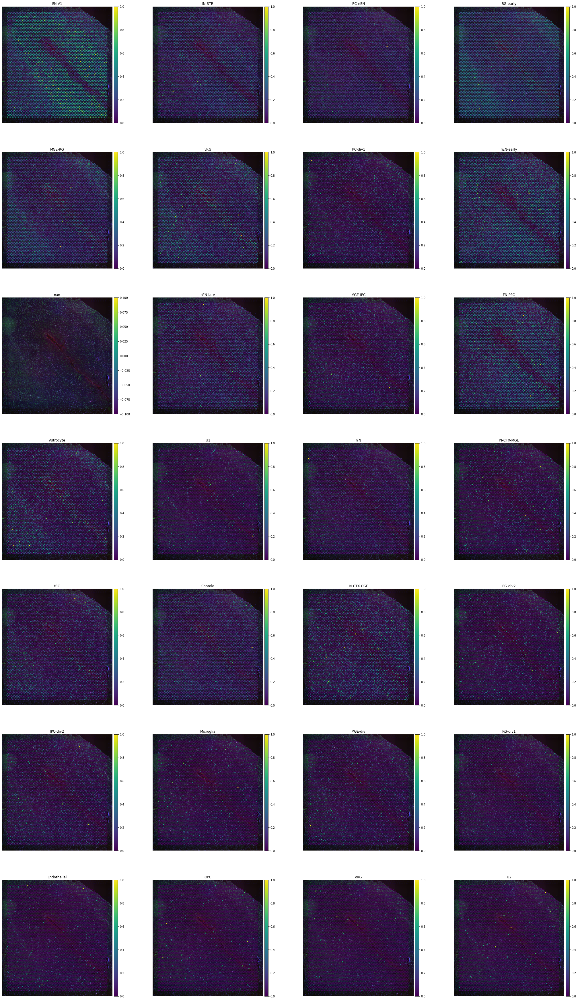

In [11]:
tg.project_cell_annotations(ad_map1, adata_st, annotation="nowakowski_med")
annotation_list = list(pd.unique(adata_sc1.obs['nowakowski_med']))
tg.plot_cell_annotation_sc(adata_st, annotation_list)

INFO:root:spatial prediction dataframe is saved in `obsm` `tangram_ct_pred` of the spatial AnnData.


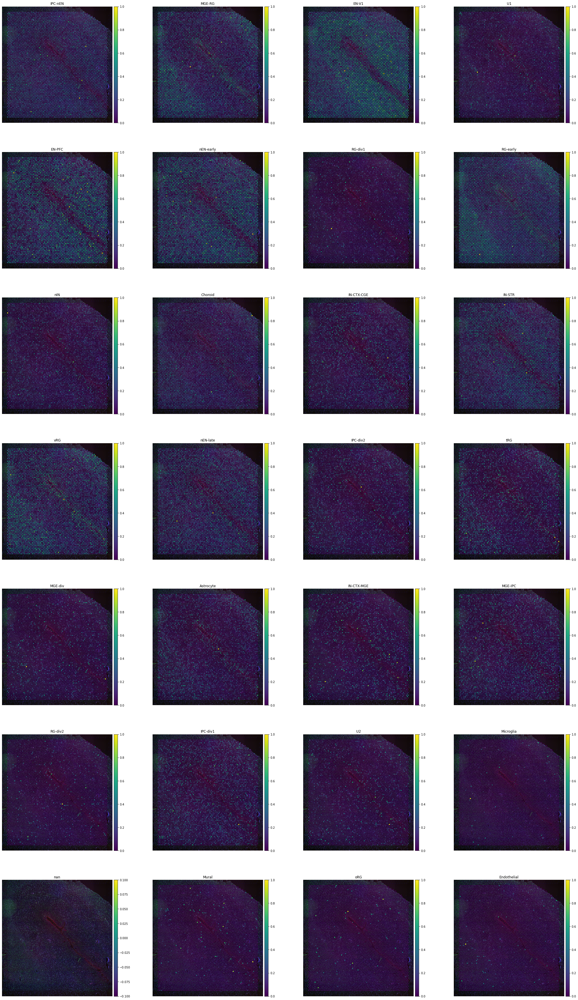

In [12]:
tg.project_cell_annotations(ad_map2, adata_st_cp, annotation="nowakowski_med")
annotation_list = list(pd.unique(adata_sc2.obs['nowakowski_med']))
tg.plot_cell_annotation_sc(adata_st_cp, annotation_list)

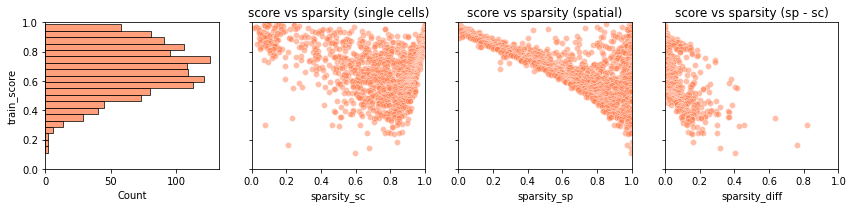

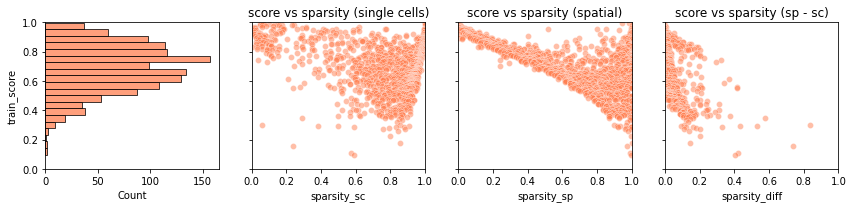

In [13]:
tg.plot_training_scores(ad_map1, bins=20, alpha=.5)
tg.plot_training_scores(ad_map2, bins=20, alpha=.5)

## 2.4 Generate new spatial data via aligned single cells

<Figure size 576x576 with 0 Axes>

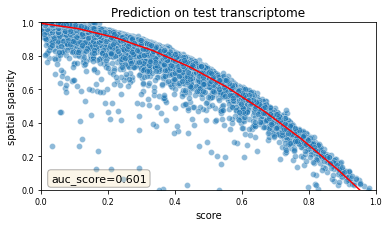

In [14]:
import gc
gc.collect()
ad_ge1 = tg.project_genes(adata_map=ad_map1, adata_sc=adata_sc1)
df_all_genes1 = tg.compare_spatial_geneexp(ad_ge1, adata_st, adata_sc1)
tg.plot_auc(df_all_genes1)

<Figure size 576x576 with 0 Axes>

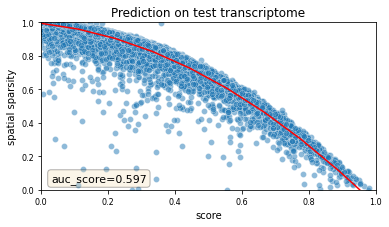

In [15]:
gc.collect()
ad_ge2 = tg.project_genes(adata_map=ad_map2, adata_sc=adata_sc2)
df_all_genes2 = tg.compare_spatial_geneexp(ad_ge2, adata_st_cp, adata_sc2)
df_all_genes2
tg.plot_auc(df_all_genes2)

In [16]:
del adata_sc
del df_all_genes1
del df_all_genes2
del ad_map1
del ad_map2
del adata_sc1
del adata_sc2
gc.collect()

4958

### Inspect predictions

In [17]:
# we have to use low letter
#GOI=['pax6','sox2','foxg1','neurod2','prodh','ranbp1','crkl','hira']
#GOI=['pax6','sox2','foxg1','neurod2','prodh']
GOI = ['pax6']

In [18]:
import matplotlib as mpl
mpl.style.use('ggplot')

In [19]:
gc.collect()

0

In [20]:
from matplotlib.gridspec import GridSpec
def plot_genes_double(
    genes, 
    adata_measured, 
    adata_pred1,
    adata_pred2,
    x="x",
    y = "y",
    spot_size=None, 
    scale_factor=None, 
    cmap="inferno", 
    perc=0,
    alpha_img=1.0,
    bw=False,
    return_figure=False,
    option = 10
):
    adata_measured.obs.drop(
        ["{} (measured)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )    
    adata_pred1.obs.drop(
        ["{} (group1)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )      
    adata_pred2.obs.drop(
        ["{} (group2)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )

    # prepare adatas
    tg.convert_adata_array(adata_measured)

    adata_measured.var.index = [g.lower() for g in adata_measured.var.index]
    adata_pred1.var.index = [g.lower() for g in adata_pred1.var.index]
    adata_pred2.var.index = [g.lower() for g in adata_pred2.var.index]
    
    adata_pred1.obsm = adata_measured.obsm
    adata_pred1.uns = adata_measured.uns
    adata_pred2.obsm = adata_measured.obsm
    adata_pred2.uns = adata_measured.uns
    
    # remove previous df_plot in obs
    adata_measured.obs.drop(
        ["{} (measured)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred1.obs.drop(
        ["{} (group1)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred2.obs.drop(
        ["{} (group2)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    # construct df_plot
    data = []
    for ix, gene in enumerate(genes):
        if gene not in adata_measured.var.index:
            data.append(np.zeros_like(np.array(adata_measured[:, 0].X).flatten()))
        else:
            data.append(np.array(adata_measured[:, gene].X).flatten())

    df = pd.DataFrame(
        data=np.array(data).T, columns=genes, index=adata_measured.obs.index,
    )
    tg.construct_obs_plot(df, adata_measured, suffix="measured")
    
    adata_diff = adata_pred1.copy()
    df = pd.DataFrame(
        data=np.array(adata_pred1[:, genes].X),
        columns=genes,
        index=adata_pred1.obs.index,
    )
    tg.construct_obs_plot(df, adata_pred1, perc=perc, suffix="group1")
    
    df = pd.DataFrame(
        data=np.array(adata_pred2[:, genes].X),
        columns=genes,
        index=adata_pred2.obs.index,
    )
    tg.construct_obs_plot(df, adata_pred2, perc=perc, suffix="group2")
    
    df = pd.DataFrame(
        data=np.array(adata_pred1[:,genes].X - adata_pred2[:, genes].X),
        columns=genes,
        index=adata_pred1.obs.index,
    )
    tg.construct_obs_plot(df, adata_diff, perc=perc, suffix="diff")

    fig = plt.figure(figsize=(55, len(genes) * 7))
    gs = GridSpec(len(genes), 7, figure=fig, wspace = 0.7)

    #non visium data
    if 'spatial' not in adata_measured.obsm.keys():
        #add spatial coordinates to obsm of spatial data 
        coords = [[x,y] for x,y in zip(adata_measured.obs[x].values,adata_measured.obs[y].values)]
        adata_measured.obsm['spatial'] = np.array(coords)
        coords = [[x,y] for x,y in zip(adata_pred1.obs[x].values,adata_pred1.obs[y].values)]
        adata_pred1.obsm['spatial'] = np.array(coords)
        coords = [[x,y] for x,y in zip(adata_pred2.obs[x].values,adata_pred2.obs[y].values)]
        adata_pred2.obsm['spatial'] = np.array(coords)
        coords = [[x,y] for x,y in zip(adata_diff.obs[x].values,adata_diff.obs[y].values)]
        adata_diff.obsm['spatial'] = np.array(coords)
            
    if ("spatial" not in adata_measured.uns.keys()) and (spot_size==None and scale_factor==None):
        raise ValueError("Spot Size and Scale Factor cannot be None when ad_sp.uns['spatial'] does not exist")
    val_1 = adata_pred1[:, genes].X
    val_2 = adata_pred2[:, genes].X

    for ix, gene in enumerate(genes):
        ax_m = fig.add_subplot(gs[ix, 0])
        #adata_st spatial
        sc.pl.spatial(
            adata_measured,
            spot_size=spot_size,
            scale_factor=scale_factor,
            color=["{} (measured)".format(gene)],
            frameon=False,
            ax=ax_m,
            show=False,
            cmap=cmap,
            alpha_img=alpha_img,
            bw=bw
        )
        #group1 spatial
        ax_p1 = fig.add_subplot(gs[ix, 1])
        sc.pl.spatial(
            adata_pred1,
            spot_size=spot_size,
            scale_factor=scale_factor,
            color=["{} (group1)".format(gene)],
            frameon=False,
            ax=ax_p1,
            show=False,
            cmap=cmap,
            alpha_img=alpha_img,
            bw=bw
        )
        #group2 spatial
        ax_p2 = fig.add_subplot(gs[ix, 2])
        sc.pl.spatial(
            adata_pred2,
            spot_size=spot_size,
            scale_factor=scale_factor,
            color=["{} (group2)".format(gene)],
            frameon=False,
            ax=ax_p2,
            show=False,
            cmap=cmap,
            alpha_img=alpha_img,
            bw=bw
        )
        # sigma based plotting
        ax_p3 = fig.add_subplot(gs[ix, 3])        
        coord = adata_pred1.obsm['spatial']
        val_diff = val_1[:,ix] - val_2[:, ix]
        df = pd.DataFrame(coord)
        df.columns = ['x', 'y']
        df['val'] = val_diff
        
        #This part shows top left part of the data
        df_min = df[(df['x'] < 5500) & (df['y'] < 3000)]
        print(df_min.head())
        
        mu = np.mean(df['val'])
        sig = np.std(df['val'])
        df['norm_val'] = (df['val'] - mu)/sig
        labels = ['>2σ', '1.5~2σ', '1~1.5σ', '0.5~1σ', '-0.5~0σ', '0~0.5σ', '-1.0~-0.5σ', '-1.5~-1.0σ', '-2.0~-1.5σ', '<-2σ']
        vis_label = []
        for i in range(0, 10):
            appen = ""
            if i ==0:
                appen = "{:.3f}".format(mu + 2*sig) + "~ (" + labels[i] + ")"
            elif i == 9:
                appen = "~"+ "{:.3f}".format(mu - 2*sig) + " (" + labels[i] + ")"
            else:
                appen = "{:.3f}".format(mu + (2 - 0.5*i)*sig) + "~" + "{:.3f}".format(mu + (2.5 - 0.5*i)*sig) + " (" + labels[i] + ")"
            vis_label.append(appen)
  
        df['norm_label'] = np.select(
            [df['norm_val'] > 2,
             df['norm_val'].between(1.5, 2) ,
             df['norm_val'].between(1.0, 1.5),
             df['norm_val'].between(0.5, 1.0),
             df['norm_val'].between(-0.5, 0) ,
             df['norm_val'].between(0, 0.5) ,
             df['norm_val'].between(-1.0, -0.5),
             df['norm_val'].between(-1.5, -1.0),
             df['norm_val'].between(-2.0, -1.5),
            df['norm_val'] < -2],
            vis_label,
            np.nan
        )
          
        kws = {"s":10, "linewidth": 0}
        div_cmap = sns.diverging_palette(0, 255, sep = 2, n = 10, center = "light")
        ax = sns.scatterplot(data = df, x = "x", y = "y", hue = "norm_label", hue_order = vis_label, palette = div_cmap, **kws)
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.gca().invert_yaxis()
        plt.gca().set_aspect('equal', adjustable='box')
        plt.axis('off')
        argmax = np.max(np.abs(df['val']))
        gc.collect()
        '''
        #difference spatial
        sc.pl.spatial(
            adata_diff,
            spot_size=spot_size,
            scale_factor=scale_factor,
            color=["{} (diff)".format(gene)],
            frameon=False,
            ax=ax_p3,
            show=False,
            cmap=cmap,
            alpha_img=alpha_img,
            bw=bw
        )
        '''
        # linear difference map
        ax_p4 = fig.add_subplot(gs[ix, 4])    
        min = np.min(df['val'])
        max = np.max(df['val'])
        sec_len = (max - min )/ option
        vis_label = []
        for i in range(0, option):
            appen = "{:.3f}".format(min + i * sec_len) + "~" + "{:.3f}".format(min + (i+1)*sec_len)
            vis_label.append(appen)
            df.loc[(min + i *sec_len <= df['val']) & (df['val']< min+ (i+1)*sec_len), 'norm_label'] = appen
        df.loc[df['val'] == max, 'norm_label'] = vis_label[-1]
          
        kws = {"s":10, "linewidth": 0}
        con_cmap = sns.color_palette(cmap, n_colors = option)
        ax = sns.scatterplot(data = df, x = "x", y = "y", hue = "norm_label", hue_order = vis_label, palette = con_cmap, **kws)
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], title='Line', loc='upper left')
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.gca().invert_yaxis()
        plt.gca().set_aspect('equal', adjustable='box')
        plt.axis('off')
        argmax = np.max(np.abs(df['val']))
        
        # double histogram
        ax_p5= fig.add_subplot(gs[ix, 5])
        sns.histplot(data = val_1[:,ix], color = "skyblue", label = "group1", alpha = 0.5)
        sns.histplot(data = val_2[:,ix], color = "red", label = "group2", alpha = 0.5)
        plt.legend(bbox_to_anchor=(1.15, 1), borderaxespad=0, labelcolor = 'black')

        # difference histogram
        ax_p6= fig.add_subplot(gs[ix, 6])
        sns.histplot(data = val_diff, color = "skyblue", label = "diff", alpha = 0.5)

    # remove df_plot in obs
    adata_measured.obs.drop(
        ["{} (measured)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred1.obs.drop(
        ["{} (group1)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred2.obs.drop(
        ["{} (group2)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )

    if return_figure==True:
        return fig

        x     y       val
329  4913  2575 -0.161479


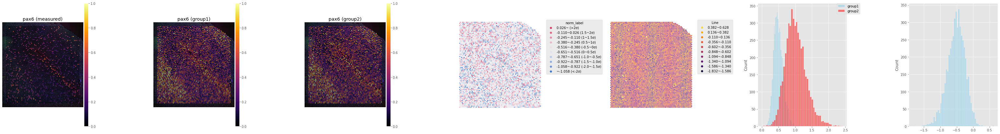

In [21]:
#fig1 = tg.plot_genes_sc(GOI, adata_measured=adata_st, adata_predicted=ad_ge1, perc=0.02, return_figure=True)
#fig2 = tg.plot_genes_sc(GOI, adata_measured=adata_st, adata_predicted=ad_ge2, perc=0.02, return_figure=True)
GOIs=['pax6']
plot_genes_double(GOIs, adata_measured = adata_st, adata_pred1 = ad_ge1, adata_pred2 = ad_ge2, perc=0.02, option = 10)
#GOIs=['neurod2','prodh']
#plot_genes_double(GOIs, adata_measured = adata_st, adata_pred1 = ad_ge1, adata_pred2 = ad_ge2, perc=0.02, option = 10)

# difference image
# histogram 1 & 2 

In [ ]:
from matplotlib.gridspec import GridSpec
def plot_genes_for_final(
    genes, 
    adata_measured, 
    adata_pred1,
    adata_pred2,
    x="x",
    y = "y",
    spot_size=None, 
    scale_factor=None, 
    cmap="inferno", 
    perc=0,
    alpha_img=1.0,
    bw=False,
    return_figure=False,
    option = 10
):
    adata_measured.obs.drop(
        ["{} (measured)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )    
    adata_pred1.obs.drop(
        ["{} (group1)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )      
    adata_pred2.obs.drop(
        ["{} (group2)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )

    # prepare adatas
    tg.convert_adata_array(adata_measured)

    adata_measured.var.index = [g.lower() for g in adata_measured.var.index]
    adata_pred1.var.index = [g.lower() for g in adata_pred1.var.index]
    adata_pred2.var.index = [g.lower() for g in adata_pred2.var.index]
    
    adata_pred1.obsm = adata_measured.obsm
    adata_pred1.uns = adata_measured.uns
    adata_pred2.obsm = adata_measured.obsm
    adata_pred2.uns = adata_measured.uns
    
    # remove previous df_plot in obs
    adata_measured.obs.drop(
        ["{} (measured)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred1.obs.drop(
        ["{} (group1)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred2.obs.drop(
        ["{} (group2)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    # construct df_plot
    data = []
    for ix, gene in enumerate(genes):
        if gene not in adata_measured.var.index:
            data.append(np.zeros_like(np.array(adata_measured[:, 0].X).flatten()))
        else:
            data.append(np.array(adata_measured[:, gene].X).flatten())

    df = pd.DataFrame(
        data=np.array(data).T, columns=genes, index=adata_measured.obs.index,
    )
    tg.construct_obs_plot(df, adata_measured, suffix="measured")
    
    adata_diff = adata_pred1.copy()
    df = pd.DataFrame(
        data=np.array(adata_pred1[:, genes].X),
        columns=genes,
        index=adata_pred1.obs.index,
    )
    tg.construct_obs_plot(df, adata_pred1, perc=perc, suffix="group1")
    
    df = pd.DataFrame(
        data=np.array(adata_pred2[:, genes].X),
        columns=genes,
        index=adata_pred2.obs.index,
    )
    tg.construct_obs_plot(df, adata_pred2, perc=perc, suffix="group2")
    
    df = pd.DataFrame(
        data=np.array(adata_pred1[:,genes].X - adata_pred2[:, genes].X),
        columns=genes,
        index=adata_pred1.obs.index,
    )
    tg.construct_obs_plot(df, adata_diff, perc=perc, suffix="diff")

    fig = plt.figure(figsize=(30, len(genes) * 9))
    gs = GridSpec(len(genes), 3, figure=fig, wspace = 0.7)

    #non visium data
    if 'spatial' not in adata_measured.obsm.keys():
        #add spatial coordinates to obsm of spatial data 
        coords = [[x,y] for x,y in zip(adata_measured.obs[x].values,adata_measured.obs[y].values)]
        adata_measured.obsm['spatial'] = np.array(coords)
        coords = [[x,y] for x,y in zip(adata_pred1.obs[x].values,adata_pred1.obs[y].values)]
        adata_pred1.obsm['spatial'] = np.array(coords)
        coords = [[x,y] for x,y in zip(adata_pred2.obs[x].values,adata_pred2.obs[y].values)]
        adata_pred2.obsm['spatial'] = np.array(coords)
        coords = [[x,y] for x,y in zip(adata_diff.obs[x].values,adata_diff.obs[y].values)]
        adata_diff.obsm['spatial'] = np.array(coords)
            
    if ("spatial" not in adata_measured.uns.keys()) and (spot_size==None and scale_factor==None):
        raise ValueError("Spot Size and Scale Factor cannot be None when ad_sp.uns['spatial'] does not exist")
    val_1 = adata_pred1[:, genes].X
    val_2 = adata_pred2[:, genes].X

    for ix, gene in enumerate(genes):
        ax_p0 = fig.add_subplot(gs[ix, 1])
        
        coord = adata_pred1.obsm['spatial']
        val_diff = val_1[:,ix] - val_2[:, ix]
        df = pd.DataFrame(coord)
        df.columns = ['x', 'y']
        df['val'] = val_diff
        mu = np.mean(df['val'])
        sig = np.std(df['val'])
        df['norm_val'] = (df['val'] - mu)/sig
        labels = ['>2σ', '1.5~2σ', '1~1.5σ', '0.5~1σ', '-0.5~0σ', '0~0.5σ', '-1.0~-0.5σ', '-1.5~-1.0σ', '-2.0~-1.5σ', '<-2σ']
        vis_label = []
        for i in range(0, 10):
            appen = ""
            if i ==0:
                appen = "{:.3f}".format(mu + 2*sig) + "~ (" + labels[i] + ")"
            elif i == 9:
                appen = "~"+ "{:.3f}".format(mu - 2*sig) + " (" + labels[i] + ")"
            else:
                appen = "{:.3f}".format(mu + (2 - 0.5*i)*sig) + "~" + "{:.3f}".format(mu + (2.5 - 0.5*i)*sig) + " (" + labels[i] + ")"
            vis_label.append(appen)
  
        df['norm_label'] = np.select(
            [df['norm_val'] > 2,
             df['norm_val'].between(1.5, 2) ,
             df['norm_val'].between(1.0, 1.5),
             df['norm_val'].between(0.5, 1.0),
             df['norm_val'].between(-0.5, 0) ,
             df['norm_val'].between(0, 0.5) ,
             df['norm_val'].between(-1.0, -0.5),
             df['norm_val'].between(-1.5, -1.0),
             df['norm_val'].between(-2.0, -1.5),
            df['norm_val'] < -2],
            vis_label,
            np.nan
        )
          
        kws = {"s":20, "linewidth": 0}
        div_cmap = sns.diverging_palette(0, 255, sep = 2, n = 10, center = "light")
        ax = sns.scatterplot(data = df, x = "x", y = "y", hue = "norm_label", hue_order = vis_label, palette = div_cmap, **kws)
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.gca().set_facecolor('black')
        plt.gca().invert_yaxis()
        plt.gca().set_aspect('equal', adjustable='box')
        plt.axis('off')
        argmax = np.max(np.abs(df['val']))
        del df
        gc.collect()
        
        ax_p1 = fig.add_subplot(gs[ix, 0])
        sc.pl.spatial(
            adata_diff,
            spot_size=spot_size,
            scale_factor=scale_factor,
            color=["{} (diff)".format(gene)],
            frameon=False,
            ax=ax_p1,
            show=False,
            cmap=cmap,
            alpha_img=alpha_img,
            bw=bw
        )
        ax_p2 = fig.add_subplot(gs[ix, 2])

        coord = adata_pred1.obsm['spatial']
        val_diff = val_1[:,ix] - val_2[:, ix]
        df = pd.DataFrame(coord)
        df.columns = ['x', 'y']
        df['val'] = val_diff
        df['norm_label'] = ""
        min = np.min(df['val'])
        max = np.max(df['val'])
        sec_len = (max - min )/ option
        vis_label = []
        for i in range(0, option):
            appen = "{:.3f}".format(min + i * sec_len) + "~" + "{:.3f}".format(min + (i+1)*sec_len)
            vis_label.append(appen)
            df.loc[(min + i *sec_len <= df['val']) & (df['val']< min+ (i+1)*sec_len), 'norm_label'] = appen
        df.loc[df['val'] == max, 'norm_label'] = vis_label[-1]

        con_cmap = sns.color_palette(cmap, n_colors = option)
        ax = sns.scatterplot(data = df, x = "x", y = "y", hue = "norm_label", hue_order = vis_label, palette = con_cmap, **kws)
        handles, labels = ax.get_legend_handles_labels()
        ax.legend(handles[::-1], labels[::-1], title='Line', loc='upper left')
        sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
        plt.gca().set_facecolor('black')
        plt.gca().invert_yaxis()
        plt.gca().set_aspect('equal', adjustable='box')
        plt.axis('off')
        argmax = np.max(np.abs(df['val']))
        del df
        gc.collect()
        

    # remove df_plot in obs
    adata_measured.obs.drop(
        ["{} (measured)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred1.obs.drop(
        ["{} (group1)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )
    adata_pred2.obs.drop(
        ["{} (group2)".format(gene) for gene in genes],
        inplace=True,
        errors="ignore",
        axis=1,
    )

    if return_figure==True:
        return fig
GOIs=['sox2','foxg1','neurod2','prodh']
plot_genes_for_final(GOIs, adata_measured = adata_st, adata_pred1 = ad_ge1, adata_pred2 = ad_ge2, perc=0.02, option = 10)

two kinds of data, one is the patient the other is control and if we can predicted(control) predicted(patient).

[<AxesSubplot:title={'center':'pax6'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'sox2'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'foxg1'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'neurod2'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'prodh'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'ranbp1'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'crkl'}, xlabel='spatial1', ylabel='spatial2'>,
 <AxesSubplot:title={'center':'hira'}, xlabel='spatial1', ylabel='spatial2'>]

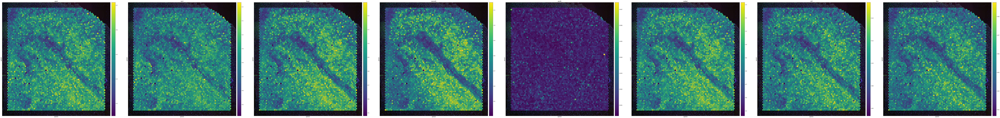

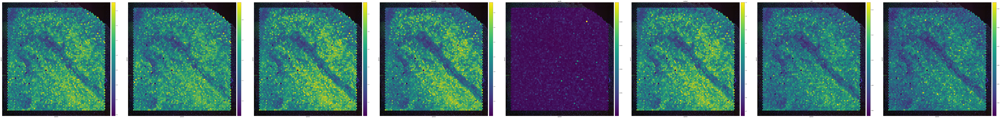

In [118]:
plt.rcParams["figure.figsize"] = (20, 20)
n_column = len(GOI)
ad = ad_ge1.copy()
sc.pl.spatial(
  ad,
  ncols = n_column,
  img_key="hires",
  color=GOI,
  size = 1.5,
  palette=[
    v
    for k, v in clusters_colors.items()
    if k in ad.obs.clusters.unique().tolist()
    ],
  legend_loc='right margin',
  show=False,
    )
ad = ad_ge2.copy()
sc.pl.spatial(
  ad,
  ncols = n_column,
  img_key="hires",
  color=GOI,
  size = 1.5,
  palette=[
    v
    for k, v in clusters_colors.items()
    if k in ad.obs.clusters.unique().tolist()
    ],
  legend_loc='right margin',
  show=False,
    )

## 2.5 Deconvolution via alignment

In [43]:
sf = adata_st.uns['spatial']['V1_Human_Brain_Section_1']["scalefactors"]["tissue_hires_scalef"]
img = sq.im.ImageContainer(adata_st.uns['spatial']['V1_Human_Brain_Section_1']['images']['hires'],
                           scale = sf, library_id = 'V1_Human_Brain_Section_1')

In [44]:
sq.im.process(img=img, layer="image", method="smooth")
sq.im.segment(                                                                                
    img=img,
    layer="image_smooth",
    method="watershed",
    channel=0,
)

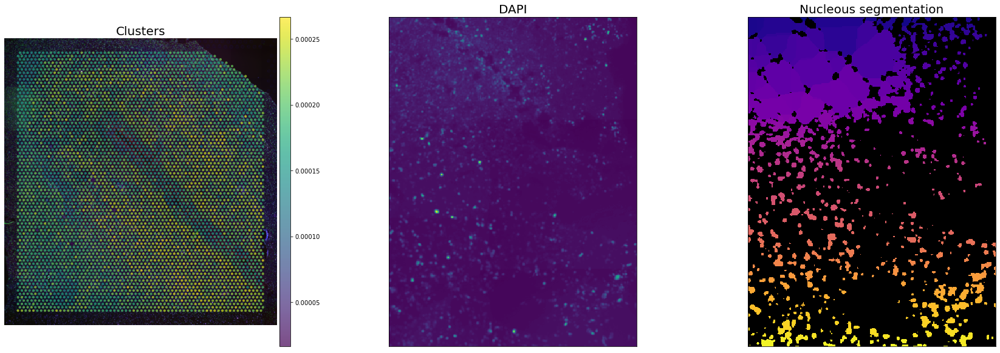

In [45]:
inset_y = 1500
inset_x = 1700
inset_sy = 400
inset_sx = 500

fig, axs = plt.subplots(1, 3, figsize=(30, 10))
# spatial how?
sc.pl.spatial(
    adata_st, 
    color="rna_count_based_density",   
    alpha=0.7, frameon=False, show=False, ax=axs[0], title=""
)
axs[0].set_title("Clusters", fontdict={"fontsize": 20})
rect = mpl.patches.Rectangle(
    (inset_y * sf, inset_x * sf),
    width=inset_sx * sf,
    height=inset_sy * sf,
    ec="yellow",
    lw=4,
    fill=False,
)
axs[0].add_patch(rect)

axs[0].axes.xaxis.label.set_visible(False)
axs[0].axes.yaxis.label.set_visible(False)

axs[1].imshow(
    img["image"][inset_y : inset_y + inset_sy, inset_x : inset_x + inset_sx, 0, 0]
    / 65536,
    interpolation="none",
)
axs[1].grid(False)
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_title("DAPI", fontdict={"fontsize": 20})

crop = img["segmented_watershed"][
    inset_y : inset_y + inset_sy, inset_x : inset_x + inset_sx
].values.squeeze(-1)
crop = skimage.segmentation.relabel_sequential(crop)[0]
cmap = plt.cm.plasma
cmap.set_under(color="black")
axs[2].imshow(crop, interpolation="none", cmap=cmap, vmin=0.001)
axs[2].grid(False)
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_title("Nucleous segmentation", fontdict={"fontsize": 20});

In [46]:
features_kwargs = {
    "segmentation": {
        "label_layer": "segmented_watershed",
        "props": ["label", "centroid"],
        "channels": [1, 2],
    }
}
# calculate segmentation features
sq.im.calculate_image_features(
    adata_st,
    img,
    layer="image",
    key_added="image_features",
    n_jobs=4,
    features_kwargs=features_kwargs,
    features="segmentation",
    mask_circle=True,
)

  0%|          | 0/4910 [00:00<?, ?/s]

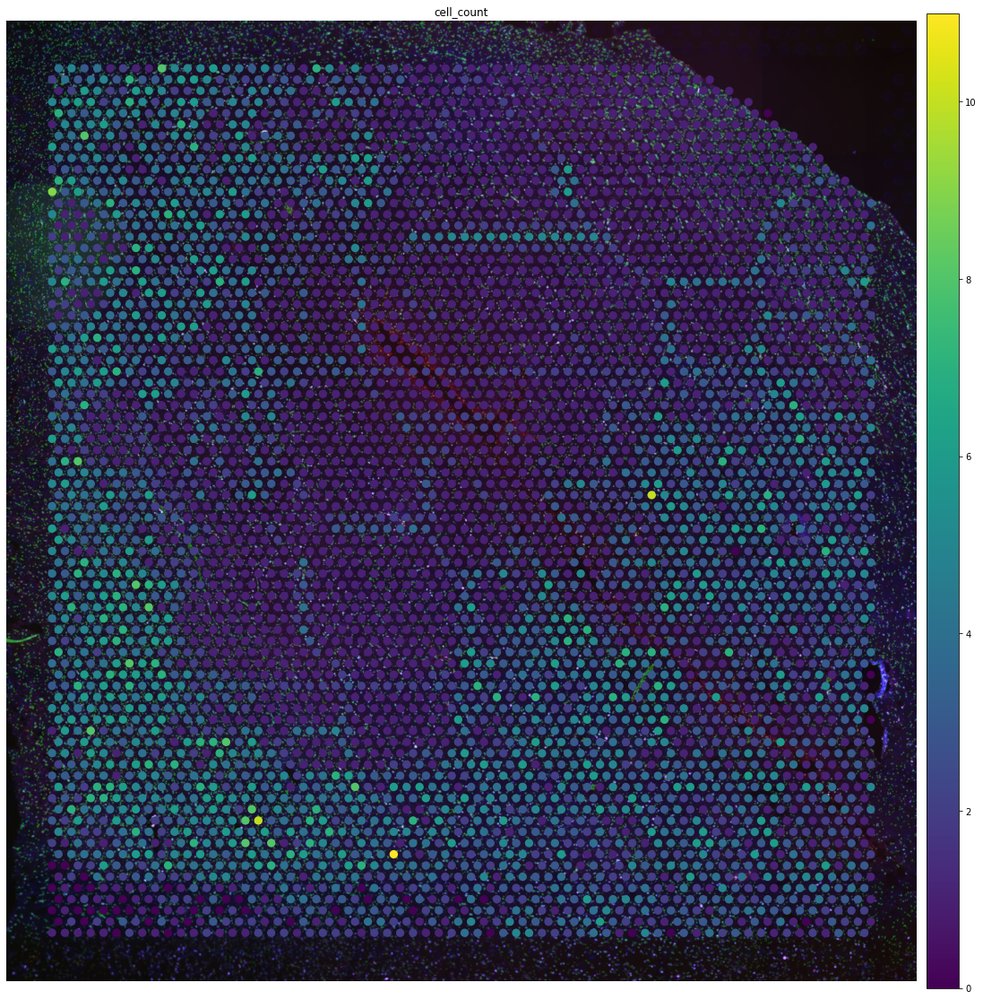

In [47]:
adata_st.obs["cell_count"] = adata_st.obsm["image_features"]["segmentation_label"]
sc.pl.spatial(adata_st, color=["cell_count"], frameon=False)

In [48]:
adata_st.obsm['image_features']

,segmentation_label,segmentation_centroid
AAACAAGTATCTCCCA-1,1,"[[nan, nan]]"
AAACAATCTACTAGCA-1,1,"[[nan, nan]]"
AAACACCAATAACTGC-1,5,"[[1611.0, 1379.0609874152954], [1616.680272108..."
AAACAGAGCGACTCCT-1,2,"[[761.0, 496.0], [776.0, 481.0]]"
AAACAGCTTTCAGAAG-1,2,"[[1725.0, 1054.0], [1740.0, 1069.0]]"
...,...,...
TTGTTTCACATCCAGG-1,4,"[[1350.0, 1365.0], [1357.4685354691076, 1358.1..."
TTGTTTCATTAGTCTA-1,1,"[[nan, nan]]"
TTGTTTCCATACAACT-1,6,"[[1521.0, 1106.4974958263772], [1524.698901098..."
TTGTTTGTATTACACG-1,2,"[[1362.0, 1646.0], [1377.0, 1661.0]]"


In [49]:
ad = adata_st.copy()
#sq.pl.spatial_scatter(ad, color=["nowakowski_med"])

Index(['al627309.1', 'al627309.5', 'al669831.2', 'linc01409', 'fam87b',
       'linc01128', 'linc00115', 'fam41c', 'al645608.4', 'linc02593',
       ...
       'mt-cyb', 'bx004987.1', 'ac145212.1', 'mafip', 'ac011043.1',
       'al354822.1', 'ac240274.1', 'ac023491.2', 'ac007325.4', 'ac007325.2'],
      dtype='object', length=25285)


Index(['in_tissue', 'array_row', 'array_col', 'n_genes_by_counts',
       'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts',
       'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes',
       'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes',
       'clusters', 'uniform_density', 'rna_count_based_density', 'cell_count'],
      dtype='object')

In [79]:
tg.create_segment_cell_df(ad)
ad.uns["tangram_cell_segmentation"].head()

,spot_idx,y,x,centroids
0,AAACAAGTATCTCCCA-1,NaN,NaN,AAACAAGTATCTCCCA-1_0
1,AAACAATCTACTAGCA-1,NaN,NaN,AAACAATCTACTAGCA-1_0
2,AAACACCAATAACTGC-1,1611.000000,1379.060987,AAACACCAATAACTGC-1_0
3,AAACACCAATAACTGC-1,1616.680272,1380.537962,AAACACCAATAACTGC-1_1
4,AAACACCAATAACTGC-1,1621.907738,1385.000000,AAACACCAATAACTGC-1_2


In [80]:
ad.obs = pd.concat([adata_st.obs, adata_st.obsm["tangram_ct_pred"]], axis=1)
annotation_list = ad_map1.obs['nowakowski_med']
annotation_list

AAACCTGAGCTCAACT-1-0       EN-V1
AAACCTGAGGAATGGA-1-0      IN-STR
AAACCTGAGTCGCCGT-1-0     IPC-nEN
AAACCTGAGTCTCCTC-1-0    RG-early
AAACCTGAGTGCCATT-1-0     IPC-nEN
                          ...   
TTTGTCAGTCCGACGT-1-1       EN-V1
TTTGTCAGTTGTCGCG-1-1    RG-early
TTTGTCATCAGTTGAC-1-1      EN-PFC
TTTGTCATCATAGCAC-1-1      EN-PFC
TTTGTCATCCAAGCCG-1-1      IN-STR
Name: nowakowski_med, Length: 14621, dtype: category
Categories (27, object): ['Astrocyte', 'Choroid', 'EN-PFC', 'EN-V1', ..., 'nIN', 'oRG', 'tRG', 'vRG']

In [81]:
ad

AnnData object with n_obs × n_vars = 4910 × 25285
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'clusters', 'uniform_density', 'rna_count_based_density', 'cell_count', 'IPC-nEN', 'MGE-RG', 'EN-V1', 'U1', 'EN-PFC', 'nEN-early', 'RG-div1', 'RG-early', 'nIN', 'Choroid', 'IN-CTX-CGE', 'IN-STR', 'vRG', 'nEN-late', 'IPC-div2', 'tRG', 'MGE-div', 'Astrocyte', 'IN-CTX-MGE', 'MGE-IPC', 'RG-div2', 'IPC-div1', 'U2', 'Microglia', nan, 'Mural', 'oRG', 'Endothelial'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'sparsity'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'overlap_genes', 'spatial', 'tra

In [82]:
def one_hot_encoding(l, keep_aggregate=False):
    df_enriched = pd.DataFrame({"cl": l})
    for i in l.unique():
        df_enriched[i] = list(map(int, df_enriched["cl"] == i))
    if not keep_aggregate:
        del df_enriched["cl"]
    return df_enriched

In [93]:
def count_cell_annotations(
    adata_map, adata_sc, adata_sp, annotation="cell_type", threshold=0.5,
):
    if "spatial" not in adata_sp.obsm.keys():
        raise ValueError(
            "Missing spatial information in AnnDatas. Please make sure coordinates are saved with AnnData.obsm['spatial']"
        )

    if "image_features" not in adata_sp.obsm.keys():
        raise ValueError(
            "Missing parameter for tangram deconvolution. Run `sqidpy.im.calculate_image_features`."
        )

    if (
        "tangram_cell_segmentation" not in adata_sp.uns.keys()
        or "tangram_spot_centroids" not in adata_sp.obsm.keys()
    ):
        raise ValueError(
            "Missing parameter for tangram deconvolution. Run `create_segment_cell_df`."
        )

    xs = adata_sp.obsm["spatial"][:, 1]
    ys = adata_sp.obsm["spatial"][:, 0]
    cell_count = adata_sp.obsm["image_features"]["segmentation_label"]

    df_segmentation = adata_sp.uns["tangram_cell_segmentation"]
    centroids = adata_sp.obsm["tangram_spot_centroids"]

    # create a dataframe
    df_vox_cells = df_vox_cells = pd.DataFrame(
        data={"x": xs, "y": ys, "cell_n": cell_count, "centroids": centroids},
        index=list(adata_sp.obs.index),
    )
    resulting_voxels = np.argmax(adata_map.X, axis=1)

    if "F_out" in adata_map.obs.keys():
        filtered_voxels_to_types = [
            (j, adata_sc.obs[annotation][k])
            for i, j, k in zip(
                adata_map.obs["F_out"], resulting_voxels, range(len(adata_sc))
            )
            if i > threshold
        ]

        vox_ct = filtered_voxels_to_types

    else:
        vox_ct = [(resulting_voxels, adata_sc.obs[annotation])]

    df_classes = one_hot_encoding(adata_sc.obs[annotation])
    for index, i in enumerate(df_classes.columns):
        df_vox_cells[i] = 0
    colnames = list(df_vox_cells.columns)
    nan_ind = colnames.index(np.nan)
    for i in range(0, len(resulting_voxels)):
        k = resulting_voxels[i]
        v = adata_sc.obs["nowakowski_med"][i]
        if(v is not np.nan):
            ind = df_vox_cells.columns.get_loc(v)
        else:
            ind = nan_ind
        df_vox_cells.iloc[k, ind] += 1
    adata_sp.obsm["tangram_ct_count"] = df_vox_cells

In [97]:
count_cell_annotations(ad_map1, adata_sc1, ad, annotation = "nowakowski_med")
count_cell_annotations(ad_map2, adata_sc2, ad, annotation = "nowakowski_med")

In [98]:
# nowakowski_med
ad.obsm["tangram_ct_count"].head()

,x,y,cell_n,centroids,IPC-nEN,MGE-RG,EN-V1,U1,EN-PFC,nEN-early,...,IN-CTX-MGE,MGE-IPC,RG-div2,IPC-div1,U2,Microglia,NaN,Mural,oRG,Endothelial
AAACAAGTATCTCCCA-1,14537,8210,1,[AAACAAGTATCTCCCA-1_0],0,0,1,0,1,1,...,0,0,0,0,0,0,0,0,0,0
AAACAATCTACTAGCA-1,3296,16323,1,[AAACAATCTACTAGCA-1_0],0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACACCAATAACTGC-1,16692,19620,5,"[AAACACCAATAACTGC-1_0, AAACACCAATAACTGC-1_1, A...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AAACAGAGCGACTCCT-1,5925,9311,2,"[AAACAGAGCGACTCCT-1_0, AAACAGAGCGACTCCT-1_1]",3,1,3,0,3,1,...,0,0,0,0,0,0,0,0,0,0
AAACAGCTTTCAGAAG-1,12865,20995,2,"[AAACAGCTTTCAGAAG-1_0, AAACAGCTTTCAGAAG-1_1]",2,0,5,0,0,2,...,0,0,0,1,0,0,0,0,0,0


In [99]:
adata_segment = tg.deconvolve_cell_annotations(ad)
adata_segment.obs.head()

,y,x,centroids,cluster
0,1611.000000,1379.060987,AAACACCAATAACTGC-1_0,IPC-nEN
1,1616.680272,1380.537962,AAACACCAATAACTGC-1_1,RG-early
2,1621.907738,1385.000000,AAACACCAATAACTGC-1_2,RG-early
3,761.000000,496.000000,AAACAGAGCGACTCCT-1_0,IPC-nEN
4,776.000000,481.000000,AAACAGAGCGACTCCT-1_1,IPC-nEN
